# DROID: A Large-Scale In-The-Wild Robot Manipulation Dataset

![](https://droid-dataset.github.io/droid/assets/index/droid_teaser.jpg)

This Colab demonstrates how to load and visualize samples from the DROID dataset. Please also check out our [dataset visualizer](https://droid-dataset.github.io/dataset.html) to explore the dataset.

You can download the full dataset (1.7TB) using:
```
gsutil -m cp -r gs://gresearch/robotics/droid <your_local_path>
```

If you'd like to download an example version of the dataset with 100 episodes first (2GB), run:
```
gsutil -m cp -r gs://gresearch/robotics/droid_100 <your_local_path>
```

If you want to use DROID for policy training, please check out our [policy training repo](https://github.com/droid-dataset/droid_policy_learning).

2026-02-15 18:21:34.538140: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


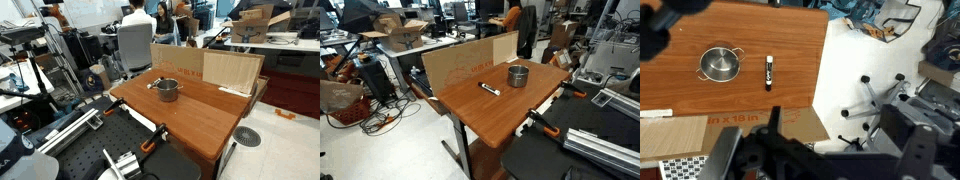

In [2]:
import tensorflow_datasets as tfds
import numpy as np
from PIL import Image
from IPython import display

def as_gif(images, path="temp.gif"):
  # Render the images as the gif (15Hz control frequency):
  images[0].save(path, save_all=True, append_images=images[1:], duration=int(1000/15), loop=0)
  gif_bytes = open(path,"rb").read()
  return gif_bytes


ds = tfds.load("droid_100", data_dir="/tmp2/hubertchang/p-progress/data", split="train")

images = []
for episode in ds.shuffle(10, seed=1).take(1):
  for i, step in enumerate(episode["steps"]):
    images.append(
      Image.fromarray(
        np.concatenate((
              step["observation"]["exterior_image_1_left"].numpy(),
              step["observation"]["exterior_image_2_left"].numpy(),
              step["observation"]["wrist_image_left"].numpy(),
        ), axis=1)
      )
    )

display.Image(as_gif(images))

In [4]:
import tensorflow_datasets as tfds
import numpy as np
import os
from moviepy.editor import ImageSequenceClip

# Configuration
DATA_DIR = "/tmp2/hubertchang/p-progress/data"
OUTPUT_DIR = "droid_samples"
NUM_SAMPLES = 50
FPS = 15

# Ensure output directory exists
os.makedirs(OUTPUT_DIR, exist_ok=True)

print(f"Loading dataset from {DATA_DIR}...")
ds = tfds.load("droid_100", data_dir=DATA_DIR, split="train")

print(f"Sampling {NUM_SAMPLES} episodes...")
# Shuffle with a buffer to get random episodes
dataset_iter = ds.shuffle(1000, seed=42).take(NUM_SAMPLES)

for i, episode in enumerate(dataset_iter):
    episode_id = f"episode_{i:03d}"
    episode_dir = os.path.join(OUTPUT_DIR, episode_id)
    os.makedirs(episode_dir, exist_ok=True)
    
    print(f"Processing {episode_id}...", end=" ")
    
    # Initialize lists for frames
    views_frames = {
        "exterior_image_1_left": [],
        "exterior_image_2_left": [],
        "wrist_image_left": []
    }
    
    # Collect frames from the episode
    for step in episode["steps"]:
        obs = step["observation"]
        for view_name in views_frames:
            if view_name in obs:
                views_frames[view_name].append(obs[view_name].numpy())
    
    # Save MP4 for each view
    saved_count = 0
    for view_name, frames in views_frames.items():
        if len(frames) > 0:
            output_path = os.path.join(episode_dir, f"{view_name}.mp4")
            try:
                clip = ImageSequenceClip(frames, fps=FPS)
                # logger=None suppresses the progress bar spam
                clip.write_videofile(output_path, codec="libx264", audio=False, logger=None)
                saved_count += 1
            except Exception as e:
                print(f"\n  Error saving {view_name}: {e}")
    
    print(f"Saved {saved_count} videos to {episode_dir}")

print(f"\nDone! All samples saved to {os.path.abspath(OUTPUT_DIR)}")

Loading dataset from /tmp2/hubertchang/p-progress/data...
Sampling 50 episodes...


2026-02-15 18:25:36.584685: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:453] ShuffleDatasetV3:450: Filling up shuffle buffer (this may take a while): 26 of 1000
2026-02-15 18:25:36.913722: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:483] Shuffle buffer filled.


Processing episode_000... Saved 3 videos to droid_samples/episode_000
Processing episode_001... 

2026-02-15 18:25:38.572388: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Saved 3 videos to droid_samples/episode_001
Processing episode_002... Saved 3 videos to droid_samples/episode_002
Processing episode_003... Saved 3 videos to droid_samples/episode_003
Processing episode_004... Saved 3 videos to droid_samples/episode_004
Processing episode_005... Saved 3 videos to droid_samples/episode_005
Processing episode_006... Saved 3 videos to droid_samples/episode_006
Processing episode_007... Saved 3 videos to droid_samples/episode_007
Processing episode_008... Saved 3 videos to droid_samples/episode_008
Processing episode_009... 

2026-02-15 18:25:47.923973: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Saved 3 videos to droid_samples/episode_009
Processing episode_010... Saved 3 videos to droid_samples/episode_010
Processing episode_011... Saved 3 videos to droid_samples/episode_011
Processing episode_012... Saved 3 videos to droid_samples/episode_012
Processing episode_013... Saved 3 videos to droid_samples/episode_013
Processing episode_014... Saved 3 videos to droid_samples/episode_014
Processing episode_015... Saved 3 videos to droid_samples/episode_015
Processing episode_016... Saved 3 videos to droid_samples/episode_016
Processing episode_017... Saved 3 videos to droid_samples/episode_017
Processing episode_018... Saved 3 videos to droid_samples/episode_018
Processing episode_019... Saved 3 videos to droid_samples/episode_019
Processing episode_020... Saved 3 videos to droid_samples/episode_020
Processing episode_021... Saved 3 videos to droid_samples/episode_021
Processing episode_022... Saved 3 videos to droid_samples/episode_022
Processing episode_023... Saved 3 videos to dr

2026-02-15 18:26:12.430384: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Saved 3 videos to droid_samples/episode_025
Processing episode_026... Saved 3 videos to droid_samples/episode_026
Processing episode_027... Saved 3 videos to droid_samples/episode_027
Processing episode_028... Saved 3 videos to droid_samples/episode_028
Processing episode_029... Saved 3 videos to droid_samples/episode_029
Processing episode_030... Saved 3 videos to droid_samples/episode_030
Processing episode_031... 

: 

In [ ]:
# Available Features (note that 'reward' is a dummy feature at the moment)
import tensorflow_datasets as tfds

builder = tfds.builder_from_directory(builder_dir="gs://gresearch/robotics/droid/1.0.0")
builder.info.features

FeaturesDict({
    'episode_metadata': FeaturesDict({
        'file_path': string,
        'recording_folderpath': string,
    }),
    'steps': Dataset({
        'action': Tensor(shape=(7,), dtype=float64),
        'action_dict': FeaturesDict({
            'cartesian_position': Tensor(shape=(6,), dtype=float64),
            'cartesian_velocity': Tensor(shape=(6,), dtype=float64),
            'gripper_position': Tensor(shape=(1,), dtype=float64),
            'gripper_velocity': Tensor(shape=(1,), dtype=float64),
            'joint_position': Tensor(shape=(7,), dtype=float64),
            'joint_velocity': Tensor(shape=(7,), dtype=float64),
        }),
        'discount': Scalar(shape=(), dtype=float32),
        'is_first': bool,
        'is_last': bool,
        'is_terminal': bool,
        'language_instruction': string,
        'language_instruction_2': string,
        'language_instruction_3': string,
        'observation': FeaturesDict({
            'cartesian_position': Tensor(shape

## Raw DROID Data

The RLDS version of the DROID dataset is optimized for loading speed during policy training. Thus, it contains lower-resolution images (180x320 px) and no stereo or depth data. If you need access to the full-HD, stereo videos we recorded, you can download the raw DROID data with the following command:
```
gsutil -m cp -r gs://gresearch/robotics/droid_raw <your_local_path>
```
Here we store data in MP4 format for more efficient storage. For more information about the raw data format, see our [developer documentation](https://droid-dataset.github.io/droid/the-droid-dataset.html).